<a href="https://colab.research.google.com/github/Alikaname/TensorFlow_Transfer_learning_Dog_Vision/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# End to end Multi-class Dog Breed Classification
This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow hub.

## 1. Problem 
Identifing the breed of the dog given an image of a dog.

## 2. Data
The data we're using is from Kaggle's dog breed identification competition.

## 3. Evaluation
The evaluation is a file with prediction probabilities for each dog breed of each test image.

## 4. Features
Some information about the data:
 * We're dealing with images (unstructured data) so its best to use deep learning/transfer learning. 
 * There are 120 different dog breeds (120 different classes).
 * There are 10,000+ images in the training set (these images have labels).
 * There are 10,000+ images in the test set (these images have no labels, because we'll want to predict them).

## Get our workspace ready
* Import TensorFlow
* Import TensorFlow hub
* Make sure we're using a GPU

In [1]:
#Import TensorFlow into colab 
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__)
print("TF Hub version", hub.__version__)

#Check for gpu availability
print("GPU", "available!" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.4.1
TF Hub version 0.11.0
GPU available!


## Getting our data ready (turning into tensors)
With all machine learning models our data has to be in numerical format. So thats what we'll be doing first. Turning our images into tensors (numerical representations).

Let's start by accessing our data and checking out the labels.

In [2]:
#Check out the labels of our data 
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Dog vision/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     2294fdf8ceba2e6846e68a9ae1099997  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


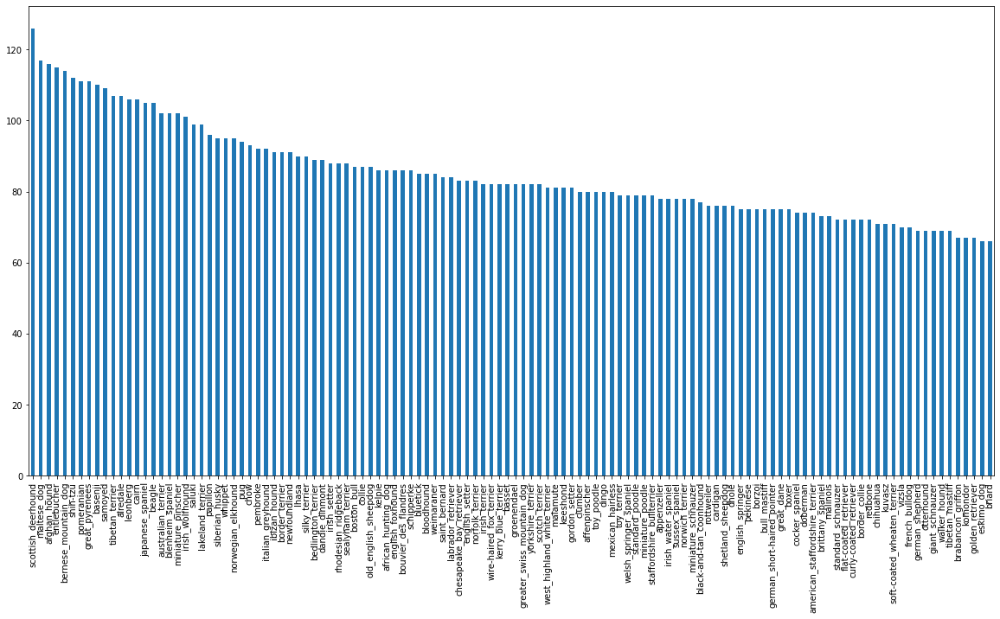

In [3]:
#how many images are there for each breed
labels_csv["breed"].value_counts().plot.bar(figsize=(20,10));

In [4]:
labels_csv['breed'].value_counts().median()

82.0

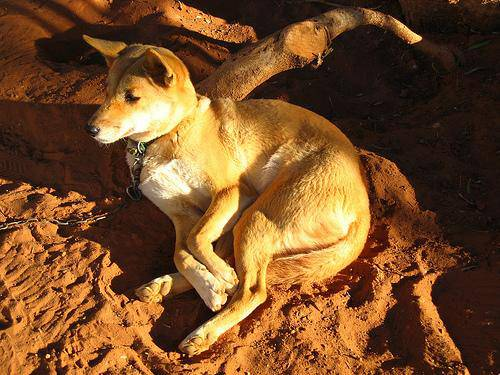

In [5]:
#Lets view the image
from IPython.display import Image
Image("drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

### Getting images and their labels
lets get a list of all our imahes and their path names

In [6]:
#Create pathnames from image ID's
filename = ["drive/MyDrive/Dog vision/train/" + fname + ".jpg" for fname in labels_csv["id"]]
#Check the first 10 
filename[:10]

['drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [7]:
#Check whether number of filenames matches number of actual image files
import os
if len(os.listdir("drive/MyDrive/Dog vision/train/")) == len(filename):
  print("Filenames match the actual amount of files! Proceed")
else:
  print("Filenames do not match the actual amount of files, check target directory")


Filenames match the actual amount of files! Proceed


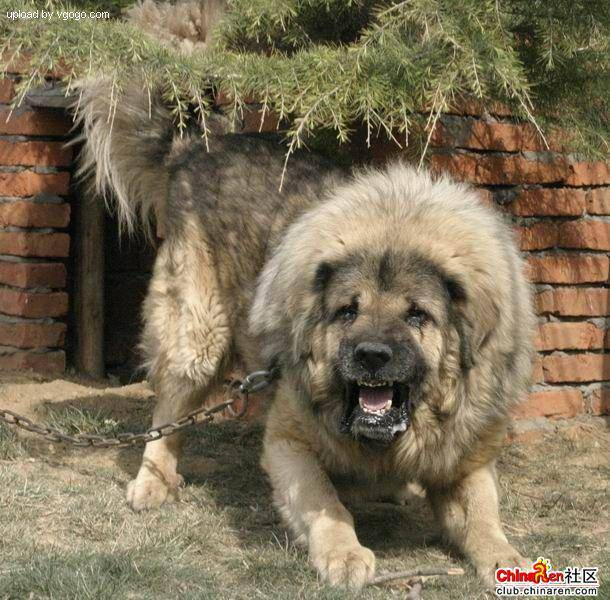

In [8]:
#One more check 
Image(filename[9000])

Since we've now got our training image filepath in a list, lets prepare the labels.

In [9]:
import numpy as np
labels = labels_csv["breed"].to_numpy()
# labels = np.array(labels) # does same thing as above
labels 

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [10]:
len(labels)

10222

In [11]:
#See if number of labels matches number of filenames
if len(labels) == len(filename):
  print("Number of labels matches number of filenames!".capitalize())
else:
  print("number of labels does not match number of filenames".capitalize())

Number of labels matches number of filenames!


In [12]:
#Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [13]:
# Turn a single label into an array of booleans
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [14]:
# Turn every label into a boolean array
boolean_labels = [label ==unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [15]:
len(boolean_labels)

10222

In [16]:
#Example: Turning boolean array into integers
print(labels[0]) #original label
print(np.where(unique_breeds == labels[0])) #index where label occurs
print(boolean_labels[0].argmax()) #index where label occurs in boolean array
print(boolean_labels[0].astype(int)) #there will be a 1 where the sample occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set
Since the dataset from Kaggle doesnt come with a validation set, we're going to create our own

In [17]:
#Setup X & y labels
X = filename
y = boolean_labels

We're going to start off experimenting with ~1000 images and increase as needed

In [18]:
#Set number of images to use for expirementing
NUM_IMAGES = 1000 #@param {type:"slider", min:100, max:10000, step:1000}

In [19]:
# Lets split our data into train and validation sets
from sklearn.model_selection import train_test_split

# Split them into training and validation according to NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=42)
len(X_train),len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [20]:
#Lets see the training data 
X_train[:2], y_train[:2]

(['drive/MyDrive/Dog vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog vision/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, Fal

## Preprocessing Images (turning images into Tensors)

To preprocess our images into Tensors we're going to write a few functions:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`
3. Turn our `image` (a jpg) into Tensors
4. Resize the `image` to be the shape of (224, 224)
5. Return the modified `image`

In [21]:
#Convert image to numpy array
from matplotlib.pyplot import imread
image = imread(filename[42])
image.shape

(257, 350, 3)

In [22]:
#Turn image into Tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

Now we've what an image looks like as a Tensor, lets make a function to preprocess them.
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`
3. Turn our `image` (a jpg) into Tensors
4. Normalize our image (convert color channel values from 0-255 to 0-1)
5. Resize the `image` to be the shape of (224, 224)
6. Return the modified `image`

In [23]:
#Define image size
IMG_SIZE = 224

#Create a function for preprocessing image
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image path and turns the image into a Tensor.
  """
  
  #Read an image file 
  image = tf.io.read_file(image_path)
  #Turn the jpg image into numerical Tensor with 3 color channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  #Convert the color channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  #Resize the image to our desired value(224,224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

## Turning our data into batches

Why turn our data into batches?

Lets say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So thats why we do about 32 images (this is the batch size) at a time (you can manually adjust the batch size if need be).

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this: `(images, labels)`


In [24]:
#Create a simple function to return a tuple (image,label)
def get_image_label(image_path, label):
  '''
  Takes an image file path name and the associated label, 
  processes the image and returns a tuple of (image, label)
  '''
  image = process_image(image_path)
  return image, label 

In [25]:
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a way to turn our data into tuples of Tensors in the form: `(image, labels)`, lets make a function to turn all our data (`X` &`y`) into batches.

In [26]:
#Set the batch size, 32 is a good start
BATCH_SIZE = 32

#Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Create Batches of data out of our image (X) and our label (y) pairs.
  Shuffles the data if its training data but doesnt shuffle if its the validation data.
  Also accepts test data as input(no labels).
  """
  #If the data is a test dataset we probably dont have any labels
  if test_data:
    print("creating test data batches...".title())
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) #only filepaths no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  #If the data is a valid dataset, we dont need to shuffle it 
  elif valid_data:
    print("creating validation data batches".title())
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), #filepaths 
                                               tf.constant(y))) #labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  
  else:
    print("creating training data batches...".title())
    #Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(y)))
    #Shuffling pathnames and labels before mapping image processor function us faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    #Create (image,label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    #Turning the data into batches 
    data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [27]:
#Creating training and validation batches
train_data = create_data_batches(X_train, y_train)
valid_data = create_data_batches(X_val, y_val, valid_data=True)

Creating Training Data Batches...
Creating Validation Data Batches


In [28]:
#Chech the different attributes of our data batches 
train_data.element_spec, valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

Our data is now in batches, however, these can be little hard to understand/comprehend lets visualize them

In [29]:
import matplotlib.pyplot as plt

#Create a function for viewing images in a data batch
def show_25_images(images, labels):
  '''
  Displays a plot of 25 images and their labels from a data batch
  '''
  #Setup a figure
  plt.figure(figsize=(15,15))
  #Loop through 25 images (for displaying 25 images)
  for i in range (25):
    #Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    #Display an image
    plt.imshow(images[i])
    #Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    #Turn the grid lines off 
    plt.axis("off")

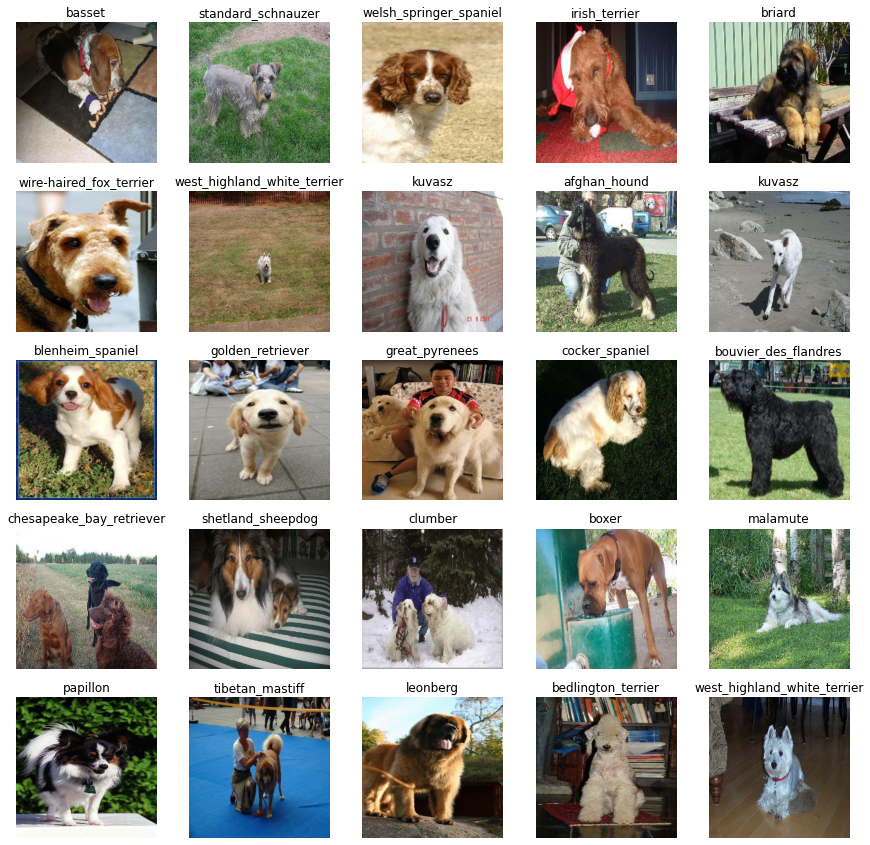

In [30]:
#Now lets visualize the data in the trainig batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

In [31]:
len(train_images), len(train_labels)

(32, 32)

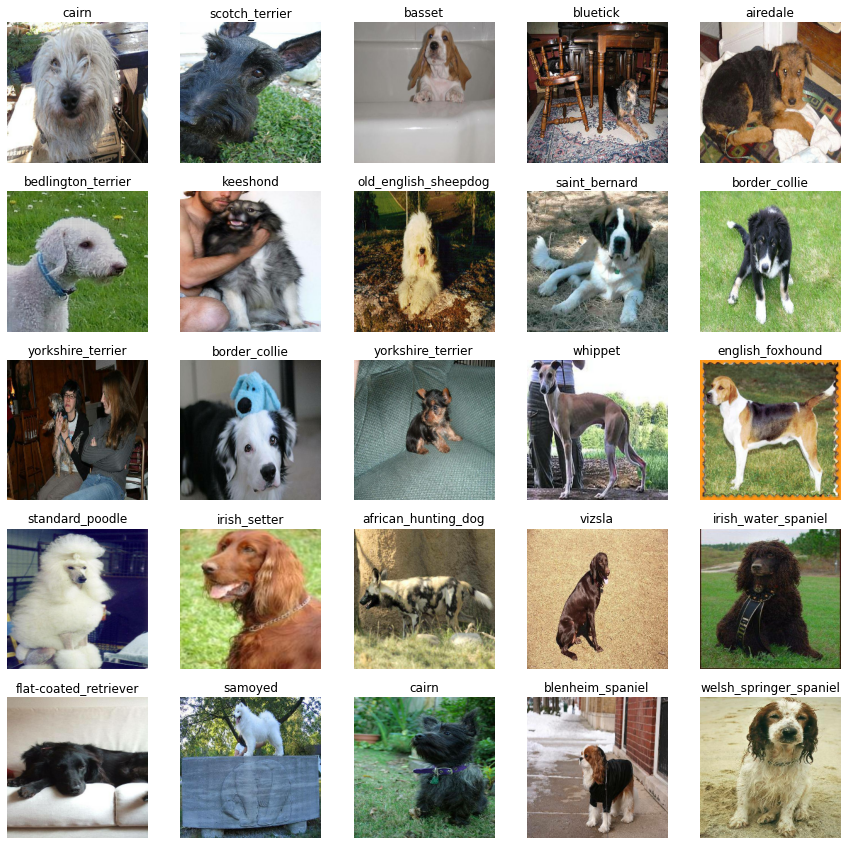

In [32]:
#Lets visaulize our validation set
val_images, val_labels = next(valid_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model 
Before we build a model, there are a few things we need to define:
* The input shape (our images shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we wnat to use.

In [33]:
#Setup input shape to the model 
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] #Batch, height, width, color channels
#Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

#Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Now we've got our inputs, outputs and model ready to go.
Lets put them together into a Keras deep learning model.

Knowing this lets create a function which:
* Takes the input shape, output shape and the model we've chosen as parameters.
* Define the layers in a Keras model in sequential fashion (do this first, then this, then that).
* Compiles the model (says it should be evaluated and improved).
* Builds the model (tells the model the input shape it will be getting).
* Return the model.

In [34]:
#Create a function that builds a keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("building model with: ".title(), model_url)

  #Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(model_url), #Layer 1 (input layer)
    tf.keras.layers.Dense(units=output_shape,
                          activation="softmax")  #Layer 2 (output layer)
  ])
  #Compile the model 
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"])
  
  #Build the model 
  model.build(input_shape)

  return model

In [35]:
model = create_model()
model.summary()

Building Model With:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating Callbacks

callbacks are helper functions a model can use during training to do such things as save its progress, check its progress or stop training early if a model stops improving.

We'll create 2 callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training too long.
### TensorBoard Callback 
To setup a TensorBoard callback we need to do 3 things:
1. Load the TensorBoard extention.
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualize our models training logs with `%tensorboard` magic function (we'll do this after model training).

In [36]:
#Load TensorBoard notebook extention
%load_ext tensorboard

In [37]:
import datetime

#Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  #Create a log directory for storing TensorBoard Logs
  logdir = os.path.join("drive/MyDrive/Dog vision/logs",
                        #Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping Callback

Early Stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving. 

In [38]:
#Create early stopping call back
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

## Training a model (on a subset of data)
our first model is only going to train on 1000 images, to make sure everything is working.

In [39]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [40]:
#Check to make sure we're still running a gpu
print("GPU", 'available' if tf.config.list_physical_devices("GPU") else "not available")

GPU available


Lets create a simple function which trains a model

* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data and the number of epochs to train for (`NUM_EPOCHS`) and the callbacks we'll use 
* Return the model

In [41]:
#Build a function to train and return a trained model 
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  #Create a model
  model = create_model()

  #Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #Fit the model to the data passing it the callbacks we've created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=valid_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  #Return the fitted model 
  return model

In [42]:
model = train_model()

Building Model With:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 515s 20s/step - loss: 5.3484 - accuracy: 0.0425 - val_loss: 3.5502 - val_accuracy: 0.1950
Epoch 2/100
25/25 [==============================] - 4s 171ms/step - loss: 1.9405 - accuracy: 0.6277 - val_loss: 2.1672 - val_accuracy: 0.5050
Epoch 3/100
25/25 [==============================] - 4s 168ms/step - loss: 0.6634 - accuracy: 0.9218 - val_loss: 1.6639 - val_accuracy: 0.6150
Epoch 4/100
25/25 [==============================] - 4s 169ms/step - loss: 0.2767 - accuracy: 0.9910 - val_loss: 1.4670 - val_accuracy: 0.6600
Epoch 5/100
25/25 [==============================] - 4s 170ms/step - loss: 0.1460 - accuracy: 0.9981 - val_loss: 1.4027 - val_accuracy: 0.6500
Epoch 6/100
25/25 [==============================] - 4s 169ms/step - loss: 0.1032 - accuracy: 0.9992 - val_loss: 1.3566 - val_accuracy: 0.6700
Epoch 7/100
25/25 [=============================

**Question:** It looks like our model is overfitting because its performing fdar better on the training dataset than on the validation dataset, what are some ways to prevent model overfitting in deep learning neural networks?

**Note** Overfitting to begin with is a good thing, it means our model is learning.

### Checking the TensorBoard logs

The TensorBoard magic function(`%tensorboard`) will access logs directory we created earlier and visualize its contents

In [43]:
%tensorboard --logdir drive/MyDrive/Dog\ vision/logs

<IPython.core.display.Javascript object>

## Making and Evaluating predictions using a trained model

In [44]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(valid_data, verbose=1)
predictions

7/7 [==============================] - 1s 115ms/step


array([[1.6137335e-03, 1.3578647e-04, 2.0194738e-03, ..., 1.3336150e-03,
        2.4702389e-05, 2.1381164e-03],
       [4.8974939e-03, 3.8573859e-04, 2.0049494e-02, ..., 9.4826013e-04,
        5.7740160e-03, 6.2607136e-04],
       [3.4291438e-06, 1.0473571e-04, 3.1139676e-05, ..., 2.2343978e-04,
        4.4427172e-05, 2.6292010e-04],
       ...,
       [1.0657646e-05, 4.9347240e-05, 4.6184905e-05, ..., 4.7644560e-05,
        1.0309742e-04, 1.0832343e-04],
       [4.8247436e-03, 5.4941344e-04, 1.4089920e-04, ..., 3.9545429e-04,
        2.4783860e-05, 1.3393767e-02],
       [1.6084916e-04, 4.2146705e-05, 1.3781146e-03, ..., 3.3079828e-03,
        4.3651526e-04, 1.7098970e-04]], dtype=float32)

In [45]:
# FIRST PREDICTIONS
index = 42
print(predictions[index])
print(f"Max value(probability of predictions): {np.max(predictions[index])}")
print(f'Sum: {np.sum(predictions[index])}')
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Prediction label: {unique_breeds[np.argmax(predictions[index])]}")

[3.64045009e-05 6.98295771e-05 3.65279819e-04 2.60530913e-04
 1.04645977e-03 1.42009594e-04 6.38992351e-04 9.15536017e-04
 9.48933605e-03 2.17861161e-02 1.77507609e-04 2.37241984e-05
 6.48309244e-04 4.23270185e-03 1.47201505e-03 1.62698561e-03
 2.51332076e-05 2.05903212e-04 2.42765775e-04 2.62250949e-04
 5.54976978e-05 1.73217486e-04 1.15850387e-04 1.06889049e-04
 8.11864901e-03 6.13636512e-05 2.06869008e-04 3.36308258e-05
 8.96549725e-04 7.32710687e-05 1.33169757e-04 5.54815226e-04
 3.55294644e-04 3.29555696e-05 1.48575637e-04 1.36846735e-04
 1.92708249e-04 1.23106991e-03 9.16820863e-05 5.41363731e-02
 2.40257359e-04 7.95052692e-05 5.74066257e-03 5.14697331e-06
 3.52456438e-04 3.39041944e-05 1.91729516e-04 1.47121795e-03
 6.34359894e-05 4.44016914e-04 9.45912179e-05 5.28364617e-04
 9.03493928e-05 1.56117568e-03 3.95147508e-05 5.45172079e-04
 9.70430337e-05 3.15087163e-05 1.14111732e-04 9.80346304e-05
 2.77779443e-04 5.97463280e-04 3.56492205e-06 1.92326424e-05
 6.24552413e-05 1.234524

Having the above functionality is great but we want to do it at scale.

And it would be even better if we could see the image the prediction is being made on.

**Note:** Prediction probabilities are also known as confidence levels.

In [46]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  '''
  Turns an array of prediction probabilities into a label.
  '''
  return unique_breeds[np.argmax(prediction_probabilities)]

# Test the function
pred_label = get_pred_label(predictions[81])
pred_label

'dingo'

Now since our validation set is still in a batch set, we'll have to unbatchaify it to make predictions on the validation images and then compare those predictions to the validation levels (truth labels).

In [47]:
#Create a function to unbatch a batch dataset
def unbatchify(data):
  '''
  Takes a batched dataset of (image,label) Tensors and returns seperate arrays of images and labels
  '''
  images = []
  labels = []

  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

# Unbatchify the validation dataset
val_images, val_labels = unbatchify(valid_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [48]:
get_pred_label(val_labels[0])

'affenpinscher'

Now we've got ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

Lets make a function to better visualize them.

We'll create a function which:
* Takes an array of prediction probabilities, an array of truth labels and an array of of images and integers
* Convert the prediction probabilities to predict label.
* Plot the predicted label, its predicted probability, truth label and the target image on a single plot.


In [49]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  '''
  View the prediction, ground truth and image for sample n
  '''
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  #Get the pred label
  pred_label = get_pred_label(pred_prob)

  #Plot image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  #Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color="green"
  else:
    color="red"

  #Change plot title to be predicted, probability of prediction and truth label
  plt.title("{} {:2.0f}% {}".format(pred_label, np.max(pred_prob)*100, true_label), color=color)


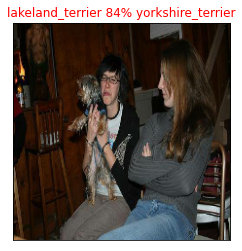

In [50]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=10)

Now we've got one function to visaulize our models top prediction, lets make another to view our models top 10 predictions.

This function will:
* Take an input of prediction probabilities array and a ground truth array and an integer.
* Find the prediction using `get_pred_label()`
* Find top 10:
  * Prediction probability indexes 
  * Prediction probability values
  * Prediction labels

* Plot the top 10 prediction probability values and labels, coloring the true label green

In [51]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  '''
  Plot the top 10 highest prediction confidences along the truth label for sample n.
  '''
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  #Get predicted label
  pred_label = get_pred_label(pred_prob)

  #Find the top 10 prediction probability indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  #Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  #Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  #Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  #Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

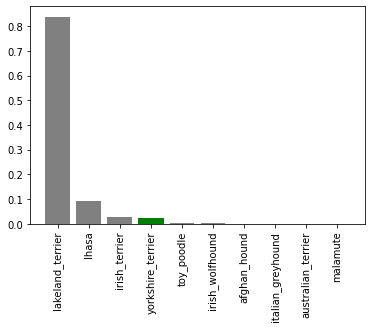

In [52]:
plot_pred_conf(predictions, val_labels, n=10)

Now we've got functions to help us visaulize our predictions and evaluate module, lets check out a few.

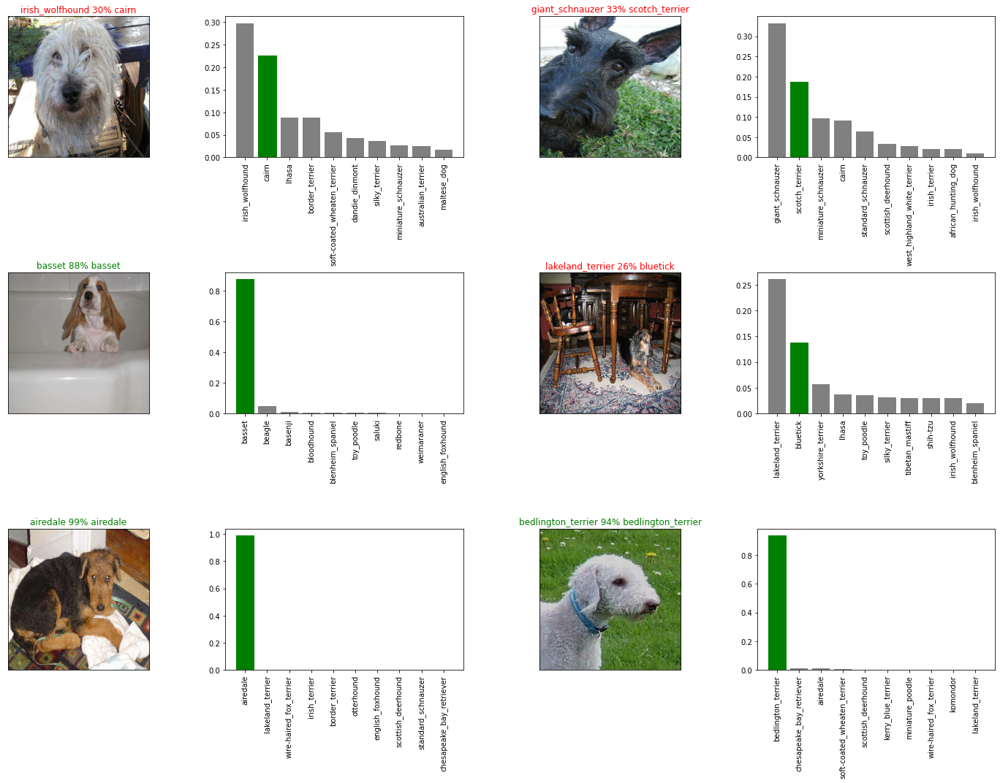

In [53]:
#Lets check out a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a trained model 

In [54]:
#Create a function to save a model
def save_model(model, suffix=None):
  '''
  Saves a given model in a models folder and appends a suffix (string).
  '''
  #Create a model directory pathname with current time
  modeldir = os.path.join('drive/MyDrive/Dog vision/models',
                          datetime.datetime.now().strftime("Y%m%d%-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" #save format of the model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [55]:
# Create a function to load a trained model 
def load_model(model_path):
  '''
  loads a saved model from a specified path
  '''
  print(f"Loading a model from: {model_path}")
  model = tf.keras.models.load_model(model_path, custom_objects={"KerasLayer": hub.KerasLayer})
  return model

Now we got functions to save and load a trained model, lets make sure they work!

In [56]:
#Save our model trained on 1000 images
save_model(model, suffix='1000-images-mobilenetv2-Adam')

Saving model to: drive/MyDrive/Dog vision/models/Y0131%H211612099295-1000-images-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog vision/models/Y0131%H211612099295-1000-images-mobilenetv2-Adam.h5'

In [57]:
loaded_1000_images = load_model('drive/MyDrive/Dog vision/models/Y0128%H061611857218-1000-images-mobilenetv2-Adam.h5')

Loading a model from: drive/MyDrive/Dog vision/models/Y0128%H061611857218-1000-images-mobilenetv2-Adam.h5


In [58]:
#Evaluate the pre saved model 
model.evaluate(valid_data)

7/7 [==============================] - 1s 108ms/step - loss: 1.2899 - accuracy: 0.6650


[1.2898838520050049, 0.6650000214576721]

In [59]:
#Evaluate the loaded model
loaded_1000_images.evaluate(valid_data)

7/7 [==============================] - 1s 113ms/step - loss: 1.2928 - accuracy: 0.6600


[1.2928135395050049, 0.6600000262260437]

## Training a big dog model (on the full data)

In [60]:
len(X), len(y)

(10222, 10222)

In [61]:
len(X_train)

800

In [62]:
#Create a data batch with the full dataset
full_data = create_data_batches(X, y)

Creating Training Data Batches...


In [63]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [64]:
#Create a model for full model 
full_model = create_model()

Building Model With:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [65]:
#Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
#No validation dataset when training on all data, so we cant monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

**Note** Running the cell below will take a little while (maybe up to 30 minutes for the first epoch) because the GPU we're using in the run time has to load all the images into memory

In [66]:
#Fit the full model to the full data
full_model.fit(x=full_data, epochs=NUM_EPOCHS, callbacks=[full_model_early_stopping, full_model_tensorboard])

Epoch 1/100
320/320 [==============================] - 5273s 16s/step - loss: 2.4165 - accuracy: 0.4776
Epoch 2/100
320/320 [==============================] - 38s 119ms/step - loss: 0.3957 - accuracy: 0.8871
Epoch 3/100
320/320 [==============================] - 38s 120ms/step - loss: 0.2166 - accuracy: 0.9440
Epoch 4/100
320/320 [==============================] - 39s 120ms/step - loss: 0.1475 - accuracy: 0.9658
Epoch 5/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0931 - accuracy: 0.9834
Epoch 6/100
320/320 [==============================] - 38s 118ms/step - loss: 0.0710 - accuracy: 0.9889
Epoch 7/100
320/320 [==============================] - 38s 118ms/step - loss: 0.0551 - accuracy: 0.9914
Epoch 8/100
320/320 [==============================] - 38s 118ms/step - loss: 0.0437 - accuracy: 0.9957
Epoch 9/100
320/320 [==============================] - 38s 118ms/step - loss: 0.0358 - accuracy: 0.9964
Epoch 10/100
320/320 [==============================] - 38s 119m

In [67]:
save_model(full_model, suffix="full-image-set-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog vision/models/Y0131%H051612105535-full-image-set-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog vision/models/Y0131%H051612105535-full-image-set-mobilenetv2-Adam.h5'

In [68]:
#Load in the full model
loaded_full_model = load_model("drive/MyDrive/Dog vision/models/Y0129%H031611939826-full-image-set-mobilenetv2-Adam.h5")

Loading a model from: drive/MyDrive/Dog vision/models/Y0129%H031611939826-full-image-set-mobilenetv2-Adam.h5


## Making prediction on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor Batches.

To make predictions on the test data, we'll:
* Get the test image filenames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since the test data doesnt have labels).
* Make a predictions array by passing the test batches to the `predict()` method called in our model.

In [69]:
#Load test image filenames
test_path = "drive/MyDrive/Dog vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/MyDrive/Dog vision/test/e86bb44f11c953a6d69c548e756f5a3b.jpg',
 'drive/MyDrive/Dog vision/test/f14672c3ea8086560de6b7e79f9b90d1.jpg',
 'drive/MyDrive/Dog vision/test/f00367f07cfcbb8152c9ed908d7c273f.jpg',
 'drive/MyDrive/Dog vision/test/e87771bc542cc6112c922962d8fda92b.jpg',
 'drive/MyDrive/Dog vision/test/ea23e5341ec5fc3f798ae527a4659d81.jpg',
 'drive/MyDrive/Dog vision/test/ea6d2d4271393459e70d77e1026737b5.jpg',
 'drive/MyDrive/Dog vision/test/f31bfb17e3d1800493376fffd77fed72.jpg',
 'drive/MyDrive/Dog vision/test/edf9eccee2542eb4fdc5757da38f0b46.jpg',
 'drive/MyDrive/Dog vision/test/eaacea894e9bdda125ae215081a0d9fc.jpg',
 'drive/MyDrive/Dog vision/test/f16a73d54d86c0020bf1d63a29eb024b.jpg']

In [70]:
len(test_filenames)

10357

In [71]:
#Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating Test Data Batches...


In [72]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [73]:
#Make predictions on the test data batch using the loaded full model 
test_predictions = full_model.predict(test_data, verbose=1)

324/324 [==============================] - 5872s 18s/step


In [74]:
#Save predictions (NumPy array) to csv file (for acces later)
np.savetxt("drive/MyDrive/Dog vision/preds_array.csv", test_predictions, delimiter=",") 

In [75]:
#Load predictions (NumPy array) from a csv file
test_predictions = np.loadtxt("drive/MyDrive/Dog vision/preds_array.csv", delimiter=",")

In [76]:
test_predictions[:10]

array([[7.80048172e-13, 6.67939870e-10, 8.11583266e-12, ...,
        1.97279844e-12, 4.95597825e-14, 1.04133617e-08],
       [7.32488843e-08, 1.22103756e-07, 2.53180199e-10, ...,
        2.27185012e-07, 5.84926875e-06, 2.17971544e-11],
       [8.99261732e-09, 7.17377418e-07, 1.73759323e-11, ...,
        6.94983960e-14, 1.02760123e-14, 7.78590614e-09],
       ...,
       [3.14874038e-12, 1.38710181e-08, 4.48051291e-13, ...,
        7.04971021e-13, 4.85150184e-11, 1.70029241e-10],
       [1.19261090e-08, 2.16046001e-10, 3.24250488e-10, ...,
        1.29989894e-08, 1.30926506e-04, 1.81167662e-01],
       [4.45975812e-10, 3.11290705e-07, 1.79468628e-07, ...,
        4.59353736e-11, 1.28248434e-09, 9.25255372e-10]])

In [77]:
test_predictions.shape

(10357, 120)

## Preparing test dataset prediction for kaggle submission 
Looking at the kaggle sample submission, we find that it wants our models prediction probability output in a DataFrame with an ID and a column for each different dog breed.

To create the data in this format, we'll:
* Create Pandas DF with an ID column as well as a column for each dog breed.
* Add data to the ID column by extracting test image ID's from filepaths.
* Add data to each of the dog breed columns.
* Export the DataFrame as a csv to submit to kaggle.


In [78]:
#create a pandas df
preds_df = pd.DataFrame(columns=["id"] +  list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [79]:
#Append test image IDs to predictions df
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids

In [80]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e86bb44f11c953a6d69c548e756f5a3b,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,f14672c3ea8086560de6b7e79f9b90d1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,f00367f07cfcbb8152c9ed908d7c273f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e87771bc542cc6112c922962d8fda92b,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,ea23e5341ec5fc3f798ae527a4659d81,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [81]:
#Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e86bb44f11c953a6d69c548e756f5a3b,7.80048e-13,6.6794e-10,8.11583e-12,4.1115e-10,6.92105e-14,6.07771e-05,1.78848e-10,3.31512e-13,4.33954e-12,7.8939e-12,1.55961e-12,6.55651e-09,1.95728e-06,3.1158e-08,9.4543e-11,2.07654e-09,6.21233e-13,1.38897e-12,2.16445e-11,1.56531e-12,4.59471e-12,5.77475e-15,1.4898e-10,7.09275e-10,8.6254e-07,9.86685e-13,1.74822e-13,3.2336e-15,4.38317e-12,3.35788e-10,1.12531e-13,3.42463e-10,1.51014e-07,9.86795e-11,3.54886e-10,3.62159e-13,8.05329e-12,1.68127e-13,2.97851e-08,...,4.63735e-11,6.31166e-14,2.1351e-14,6.22238e-10,1.89113e-09,3.16558e-10,4.70868e-10,1.56829e-08,6.95099e-13,1.93792e-11,5.81561e-13,3.37826e-08,4.88535e-13,8.44948e-09,1.22492e-13,1.3285e-10,1.32597e-12,4.12782e-11,4.16651e-15,2.40539e-09,3.54718e-14,3.36918e-14,5.45453e-08,3.14845e-13,6.84564e-12,1.15139e-09,2.87476e-11,7.81527e-09,1.3935e-11,1.42503e-12,1.93973e-12,3.35848e-11,5.52763e-09,1.67943e-10,1.1425e-09,1.22796e-09,1.8335e-10,1.9728e-12,4.95598e-14,1.04134e-08
1,f14672c3ea8086560de6b7e79f9b90d1,7.32489e-08,1.22104e-07,2.5318e-10,7.71184e-09,3.07602e-10,2.09241e-11,3.15269e-13,2.65412e-09,8.38497e-11,5.32265e-12,8.699e-07,1.8947e-12,1.26135e-12,5.35643e-12,5.51881e-10,1.24626e-07,6.25543e-10,8.79591e-06,1.26595e-07,7.78889e-09,4.25615e-08,1.0575e-13,2.30415e-08,1.93517e-06,9.91602e-11,6.65029e-08,1.26274e-06,9.63286e-10,5.72451e-11,1.04847e-11,8.94435e-13,5.68209e-10,3.49604e-09,0.00153948,1.44569e-13,9.14983e-07,1.60547e-12,1.2431e-10,8.20625e-10,...,5.07726e-08,5.38916e-10,1.89974e-05,1.23243e-08,8.39021e-12,1.31636e-06,5.03367e-13,1.12941e-10,6.67716e-10,1.62856e-09,3.65692e-07,2.54156e-11,3.48715e-10,1.36805e-08,2.73533e-12,4.71413e-09,4.93933e-08,0.00116394,2.80303e-08,1.95666e-15,4.96607e-08,7.95727e-10,5.16815e-07,3.55008e-06,8.77306e-09,1.38757e-08,0.00376685,2.91957e-09,9.34019e-09,5.00628e-09,1.99266e-09,5.18259e-09,1.66233e-10,1.31763e-07,1.64694e-09,1.56307e-07,1.73702e-09,2.27185e-07,5.84927e-06,2.17972e-11
2,f00367f07cfcbb8152c9ed908d7c273f,8.99262e-09,7.17377e-07,1.73759e-11,2.15761e-14,2.76053e-09,7.74681e-14,1.56956e-11,1.23294e-14,2.32674e-12,1.29161e-13,4.66087e-14,1.16521e-10,1.86391e-12,3.9012e-08,1.02437e-11,1.36671e-09,4.86094e-12,2.89736e-12,2.86335e-12,6.98309e-13,2.59687e-11,5.04074e-13,1.08944e-12,1.37279e-09,4.46816e-10,8.32713e-12,2.29743e-11,5.92543e-13,1.23571e-12,2.32166e-10,1.64458e-10,3.07657e-09,0.99999,2.48209e-08,4.63186e-11,1.71438e-10,2.85337e-13,1.42173e-13,5.19185e-17,...,2.4929e-11,1.65446e-13,9.69742e-15,6.17254e-11,7.99756e-09,2.00428e-07,3.64096e-13,1.37067e-09,7.59689e-12,3.53489e-10,4.42839e-14,9.17143e-14,6.94112e-15,4.92054e-11,1.38902e-11,1.31347e-08,8.51259e-09,4.54885e-12,2.48686e-11,1.78892e-14,9.51712e-09,2.29962e-13,1.84687e-10,2.53126e-12,2.3548e-07,1.02166e-08,3.10924e-10,6.34966e-08,4.22155e-10,3.2868e-08,1.03519e-08,1.57494e-12,3.36847e-10,1.23693e-12,6.60124e-13,5.66479e-15,1.90654e-

In [82]:
#Save our predictions dataframe to csv for submission
preds_df.to_csv("drive/MyDrive/Dog vision/full_model_1_mobilenetv2.csv", index=False)

## Making predictions on custom images
To make predictions on custom imagages, we'll:
* Get the file path of our own images.
* Turn the filepaths into data batches using `create_data_batches()`. And since our custom images wont have labels, we set the `test_data` parameter to `True`.
* Pass the custom image data batch to our model's `predict()` method.
* Convert the prediction output probabilities to prediction labels.
* Compare the predicted labels to the custom images.

In [83]:
#Get custom image filepaths
custom_path = "drive/MyDrive/Dog vision/dog/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [84]:
custom_image_paths

['drive/MyDrive/Dog vision/dog/husky2.jpg',
 'drive/MyDrive/Dog vision/dog/2e9443265ef18e9b7b002c28de8a8c9f.jpg',
 'drive/MyDrive/Dog vision/dog/cat.jpg']

In [85]:
#Turn custom images into batch dataset
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating Test Data Batches...


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [86]:
#Make predictions on the custom data 
custom_preds = full_model.predict(custom_data)

In [87]:
custom_preds.shape

(3, 120)

In [88]:
#Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range (len(custom_preds))]
custom_pred_labels

['siberian_husky', 'saint_bernard', 'west_highland_white_terrier']

In [89]:
#Get custom images
custom_images = []
#Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

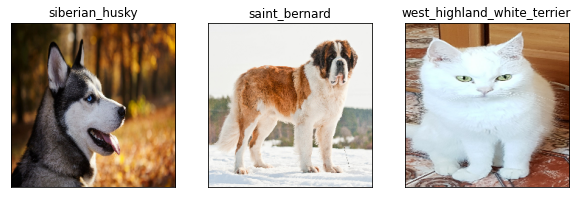

In [91]:
#Chech custom image predictions
plt.figure(figsize=(10,10))
for i, image in enumerate(custom_images):
  plt.subplot(1,3,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)